In [1]:
from dask.distributed import Client, LocalCluster
from dask import delayed, dataframe as dd
import dask

import pandas as pd
import geopandas as gpd
import math
import numpy as np

import momepy
from scripts.tessellation import enclosed_tessellation

import matplotlib.pyplot as plt

/home/virgilxw/miniconda3/envs/morph_model_v1_tess/lib/python3.11/site-packages/dask/dataframe/_pyarrow_compat.py:17: FutureWarning: Minimal version of pyarrow will soon be increased to 14.0.1. You are using 13.0.0. Please consider upgrading.
  warnings.warn(
/home/virgilxw/miniconda3/envs/morph_model_v1_tess/lib/python3.11/site-packages/tqdm/auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


In [2]:
place = "glasgow"
local_crs = 27700

In [3]:
Daskcluster = LocalCluster(threads_per_worker=2,
                n_workers=8, memory_limit='100GB')

client = Client(Daskcluster)
client

2023-11-20 18:30:08,606 - distributed.nanny.memory - WARNING - Ignoring provided memory limit 100GB due to system memory limit of 31.31 GiB
2023-11-20 18:30:08,608 - distributed.nanny.memory - WARNING - Ignoring provided memory limit 100GB due to system memory limit of 31.31 GiB
2023-11-20 18:30:08,611 - distributed.nanny.memory - WARNING - Ignoring provided memory limit 100GB due to system memory limit of 31.31 GiB
2023-11-20 18:30:08,615 - distributed.nanny.memory - WARNING - Ignoring provided memory limit 100GB due to system memory limit of 31.31 GiB
2023-11-20 18:30:08,617 - distributed.nanny.memory - WARNING - Ignoring provided memory limit 100GB due to system memory limit of 31.31 GiB
2023-11-20 18:30:08,619 - distributed.nanny.memory - WARNING - Ignoring provided memory limit 100GB due to system memory limit of 31.31 GiB
2023-11-20 18:30:08,621 - distributed.nanny.memory - WARNING - Ignoring provided memory limit 100GB due to system memory limit of 31.31 GiB
2023-11-20 18:30:08,

Connection method: Cluster object,Cluster type: distributed.LocalCluster
Dashboard: http://127.0.0.1:8787/status,
Dashboard: http://127.0.0.1:8787/status,Workers: 8
Total threads: 16,Total memory: 250.47 GiB
Status: running,Using processes: True
Comm: tcp://127.0.0.1:45013,Workers: 8
Dashboard: http://127.0.0.1:8787/status,Total threads: 16
Started: Just now,Total memory: 250.47 GiB
Comm: tcp://127.0.0.1:42987,Total threads: 2
Dashboard: http://127.0.0.1:40207/status,Memory: 31.31 GiB
Nanny: tcp://127.0.0.1:35799,


In [4]:
streets = gpd.read_parquet(f"./output/{place}/streets_raw.pq").explode().to_crs(local_crs).reset_index(drop=True)

buildings = gpd.read_parquet(f"./output/{place}/buildings_raw.pq").to_crs(local_crs)

study_area = gpd.read_parquet(f"./output/{place}/study_area.pq").to_crs(local_crs)

water = gpd.read_parquet(f"./output/{place}/water.pq").to_crs(local_crs)

/tmp/ipykernel_14930/3775211364.py:1: FutureWarning: Currently, index_parts defaults to True, but in the future, it will default to False to be consistent with Pandas. Use `index_parts=True` to keep the current behavior and True/False to silence the warning.
  streets = gpd.read_parquet(f"./output/{place}/streets_raw.pq").explode().to_crs(local_crs).reset_index(drop=True)


In [5]:
buildings['uID'] = range(1, len(buildings) + 1)

In [6]:
buildings['geometry'] = buildings['geometry'].buffer(0)

In [7]:
streets[~streets['geometry'].is_valid]

,geometry


In [8]:
buildings[~buildings['geometry'].is_valid]

,geometry,meanHeight,RegionName,quadkey,index_right,uID


In [9]:
water[~water['geometry'].is_valid]

,,geometry
element_type,osmid,


In [10]:
water_bodies_boundaries = []

# Explode the GeoDataFrame into a GeoSeries of polygons and multipolygons
gs = water.explode()

# Convert each polygon into a MultiLineString
mls = gs.geometry.boundary

# Convert the MultiLineString into a DataFrame
water_bodies = gpd.GeoDataFrame({'geometry': mls})

for water_body in water_bodies.geometry:
    # Create a LineString object from the coordinates
    water_bodies_boundaries.append(water_body)

# # Create a GeoDataFrame of the water area boundaries
water_bodies_boundaries = gpd.GeoDataFrame({'geometry': water_bodies_boundaries}).reset_index(drop=True)

/tmp/ipykernel_14930/893087771.py:4: FutureWarning: Currently, index_parts defaults to True, but in the future, it will default to False to be consistent with Pandas. Use `index_parts=True` to keep the current behavior and True/False to silence the warning.
  gs = water.explode()


In [11]:
# Create a figure and axis
fig, ax = plt.subplots(figsize=(100, 100))

# Plot study_area in green on the same axis
study_area.plot(ax=ax, color='green')

# Plot streets in blue on the same axis
streets.plot(ax=ax, color='blue')

# Plot buildings in red on the same axis
buildings.plot(ax=ax, color='red')

# Show the plot
plt.show()

In [12]:
enclosures = momepy.enclosures(gpd.GeoDataFrame(pd.concat([streets, water_bodies_boundaries], ignore_index=True))
, limit= study_area, clip=True)

/home/virgilxw/miniconda3/envs/morph_model_v1_tess/lib/python3.11/site-packages/geopandas/array.py:1459: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as OSGB36 / British National Grid (the single non-null crs provided).
  return GeometryArray(data, crs=_get_common_crs(to_concat))
/home/virgilxw/miniconda3/envs/morph_model_v1_tess/lib/python3.11/site-packages/momepy/elements.py:1069: FutureWarning: The `query_bulk()` method is deprecated and will be removed in GeoPandas 1.0. You can use the `query()` method instead.
  _, encl_index = final_enclosures.representative_point().sindex.query_bulk(


In [13]:
tessellation = momepy.Tessellation(buildings, unique_id='uID', enclosures=enclosures, use_dask = True).tessellation

# for debugging
tessellation_copy = tessellation

/home/virgilxw/miniconda3/envs/morph_model_v1_tess/lib/python3.11/site-packages/momepy/elements.py:457: FutureWarning: The `query_bulk()` method is deprecated and will be removed in GeoPandas 1.0. You can use the `query()` method instead.
  inp, res = buildings.sindex.query_bulk(
/home/virgilxw/miniconda3/envs/morph_model_v1_tess/lib/python3.11/site-packages/distributed/client.py:3163: UserWarning: Sending large graph of size 189.56 MiB.
This may cause some slowdown.
Consider scattering data ahead of time and using futures.
  warnings.warn(
/home/virgilxw/miniconda3/envs/morph_model_v1_tess/lib/python3.11/site-packages/momepy/elements.py:516: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  return pd.concat(new + [clean_blocks.drop(columns="po

In [14]:
tessellation = tessellation_copy

In [15]:
tessellation.dropna(subset=['uID'], inplace=True)

In [16]:
tessellation = tessellation.dropna().merge(buildings[["uID"]], on='uID', how='inner').sort_values(by='uID').reset_index(drop=True)
tessellation["uID"] = range(len(tessellation))

In [17]:
tessellation = tessellation.dropna().merge(buildings[["uID"]], on='uID', how='inner').sort_values(by='uID').reset_index(drop=True)
tessellation["uID"] = range(len(tessellation))
buildings = buildings.merge(tessellation.dropna()[["uID"]], on='uID', how="inner").sort_values(by='uID').reset_index(drop=True)
buildings["uID"] = range(len(buildings))

In [18]:
tessellation = tessellation.drop("eID", axis = 1)
tessellation.dropna()

,uID,geometry
0,0,"POLYGON ((245280.364 702431.549, 245280.098 70..."
1,1,"POLYGON ((261473.814 702178.805, 261473.601 70..."
2,2,"POLYGON ((251871.181 700273.852, 251871.000 70..."
3,3,"POLYGON ((251985.968 701038.007, 251986.735 70..."
4,4,"POLYGON ((261016.072 703116.505, 260988.572 70..."
...,...,...
550836,550836,"POLYGON ((271182.904 645456.744, 271182.361 64..."
550837,550837,"POLYGON ((261660.201 651822.366, 261660.250 65..."
550838,550838,"POLYGON ((290057.621 642677.346, 290057.358 64..."
550839,550839,"POLYGON ((263799.093 655046.660, 263800.596 65..."


<Axes: >

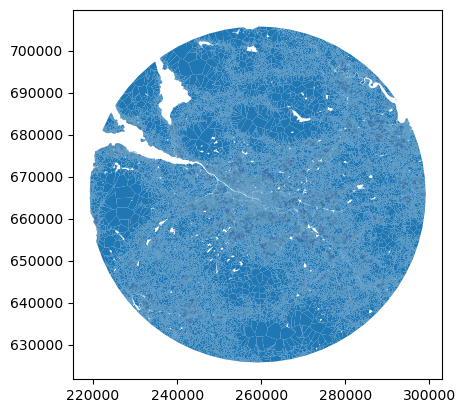

In [19]:
tessellation.plot()

In [20]:
Daskcluster.close()
client.shutdown()

In [21]:
# Convert the 'uID' column of buildings to a set for efficient lookups
uIDs_buildings = set(buildings['uID'])

# Filter the tesellation GeoDataFrame to keep only rows with uID in buildings
tessellation = tessellation[tessellation['uID'].isin(uIDs_buildings)]


In [22]:
tessellation = tessellation[["uID", "geometry"]]
buildings = buildings[["uID", "geometry"]]

In [23]:
tessellation.to_parquet(f"./output/{place}/tessellation_p1.pq")

In [24]:
buildings.to_parquet(f"./output/{place}/buildings_p1.pq")

In [25]:
client.close()